<a href="https://colab.research.google.com/github/the-actual-dev/SAPM_Portfolio_Analysis/blob/main/Portfolio_Manager.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install yfinance
import matplotlib.pyplot as plt
import statsmodels.api as sm
import yfinance as yf
import pandas as pd
import numpy as np
import seaborn as sns
import scipy.stats as stats
import scipy.optimize as sc
import plotly.graph_objects as go

# Downloading daily closing price of each stock, calculating returns and plotting the graphs






In [ ]:
import yfinance as yf
import pandas as pd

tickers = {
    'SunPharma': 'SUNPHARMA.BO',
    'SBI': 'SBIN.BO',
    'Eternal': 'ETERNAL.BO',
    'Infosys': 'INFY.BO',
    'Hindunilvr': 'HINDUNILVR.BO',
    'Sensex': '^BSESN'
}

stock_data_df = None

for name, ticker in tickers.items():
    df = yf.download(
        ticker,
        start='2024-04-01',
        end='2025-03-31',
        progress=False,
        interval='1d',
        auto_adjust=False
    )

    if isinstance(df.columns, pd.MultiIndex):
        df.columns = ['_'.join(col).strip() for col in df.columns.values]

    adj_close_col = [col for col in df.columns if 'Adj Close' in col][0]
    df = df[[adj_close_col]].rename(columns={adj_close_col: name})

    df.reset_index(inplace=True)
    if stock_data_df is None:
        stock_data_df = df
    else:
        stock_data_df = pd.merge(stock_data_df, df, how='inner', on='Date')

stock_data_df.set_index('Date', inplace=True)

display(stock_data_df.head())


,SunPharma,SBI,Eternal,Infosys,Hindunilvr,Sensex
Date,,,,,,
2024-04-01,1610.614136,731.014099,184.550003,1408.244751,2241.008057,74014.546875
2024-04-02,1601.972534,739.835999,183.050003,1396.382202,2240.861084,73903.906250
2024-04-03,1602.318237,743.306946,178.399994,1394.075684,2220.574463,73876.820312
2024-04-04,1599.947754,732.026428,186.949997,1399.583252,2220.329590,74227.632812
2024-04-05,1589.232056,736.943481,190.500000,1392.898804,2222.436279,74248.218750


In [ ]:
returns = pd.DataFrame(index=stock_data_df.index)

for column in stock_data_df.columns:
    returns[column] = (stock_data_df[column] - stock_data_df[column].shift(1)) / stock_data_df[column].shift(1)

returns.dropna(inplace=True, axis = 0)
display(returns)
returns.describe()

,SunPharma,SBI,Eternal,Infosys,Hindunilvr,Sensex
Date,,,,,,
2024-04-02,-0.005365,0.012068,-0.008128,-0.008424,-0.000066,-0.001495
2024-04-03,0.000216,0.004692,-0.025403,-0.001652,-0.009053,-0.000367
2024-04-04,-0.001479,-0.015176,0.047926,0.003951,-0.000110,0.004749
2024-04-05,-0.006698,0.006717,0.018989,-0.004776,0.000949,0.000277
2024-04-08,-0.005935,0.005299,0.006824,-0.001656,0.000639,0.006657
...,...,...,...,...,...,...
2025-03-24,0.000785,0.037716,-0.021314,-0.000251,0.003871,0.014029
2025-03-25,-0.010811,-0.010686,-0.057925,0.024808,0.006449,0.000421
2025-03-26,-0.004700,-0.012548,-0.030982,-0.020561,-0.011824,-0.009340


,SunPharma,SBI,Eternal,Infosys,Hindunilvr,Sensex
count,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000
mean,0.000374,0.000307,0.000718,0.000442,0.000075,0.000225
std,0.012657,0.018109,0.026833,0.015032,0.013022,0.008983
min,-0.044715,-0.144182,-0.109151,-0.057678,-0.058333,-0.057406
25%,-0.006713,-0.008912,-0.017232,-0.006861,-0.006990,-0.003002
50%,0.000749,0.000670,-0.000512,0.000422,-0.000614,-0.000005
75%,0.008408,0.008668,0.017352,0.008542,0.006331,0.004474
max,0.037490,0.091194,0.121102,0.041324,0.060048,0.033902


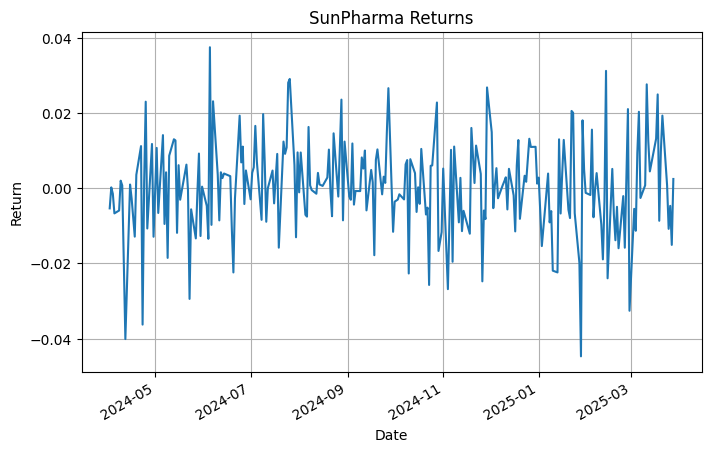

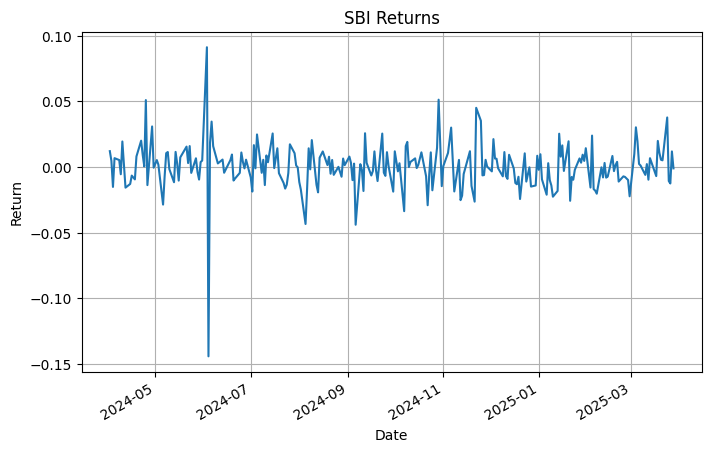

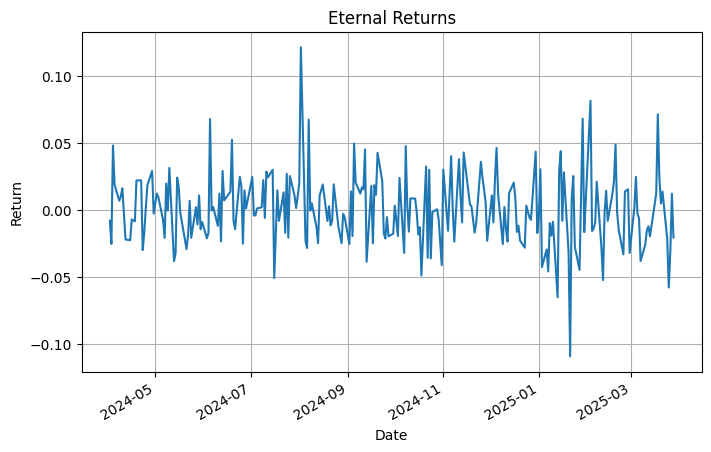

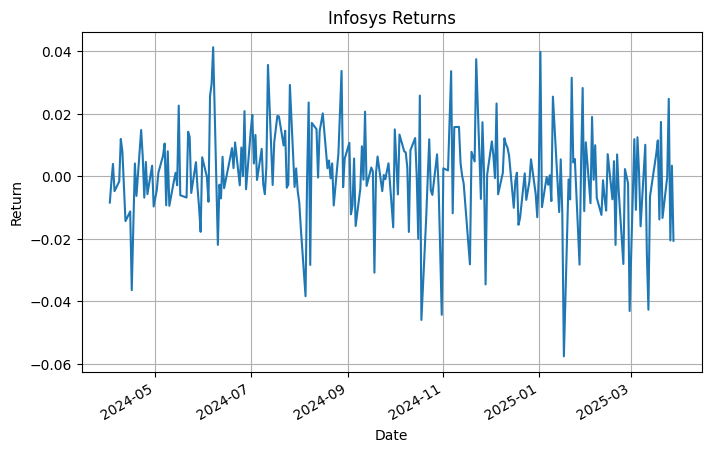

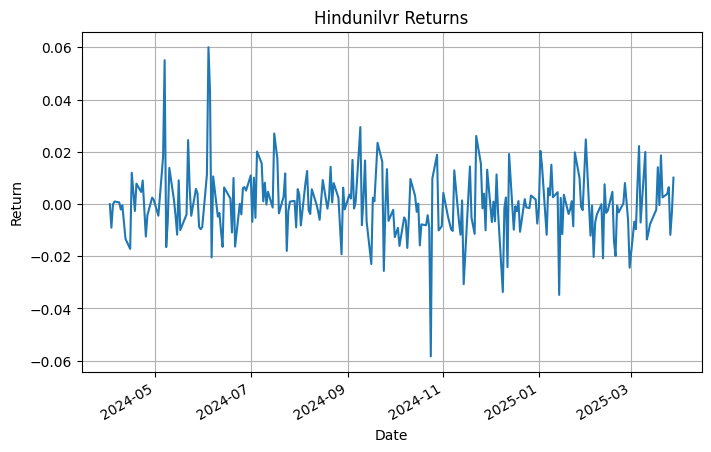

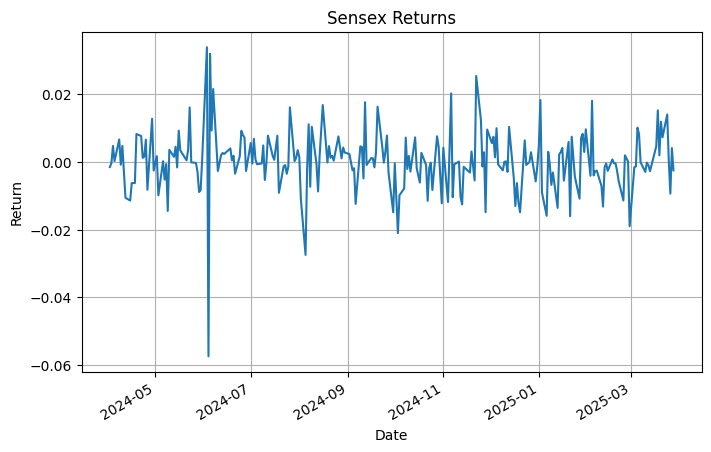

In [ ]:
for column in returns.columns:
    plt.figure(figsize=(8, 5))
    returns[column].plot()
    plt.title(f'{column} Returns')
    plt.xlabel('Date')
    plt.ylabel('Return')
    plt.grid(True)
    plt.show()

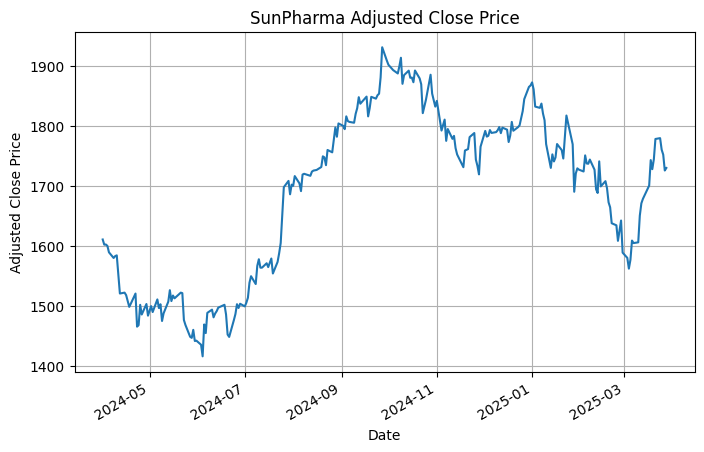

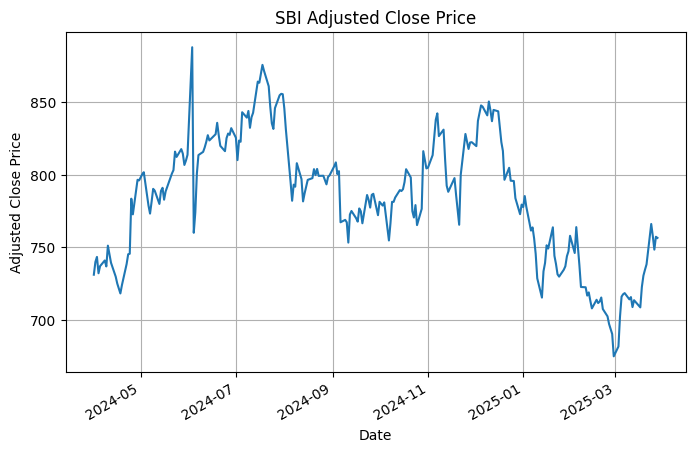

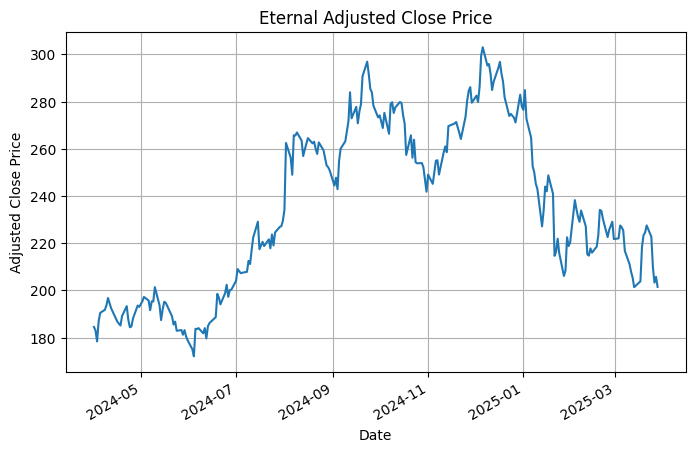

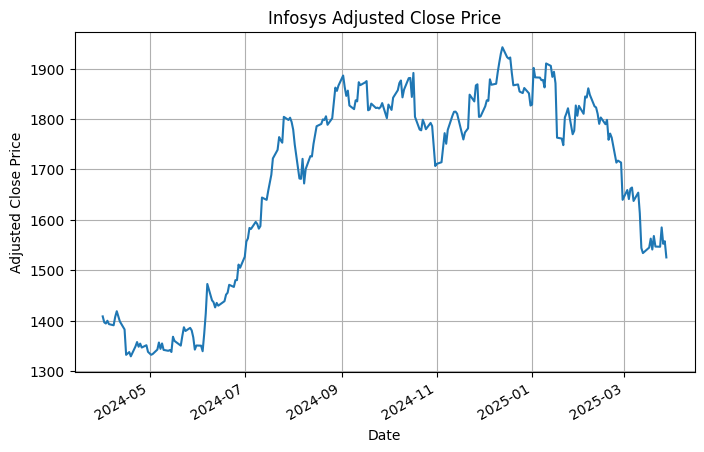

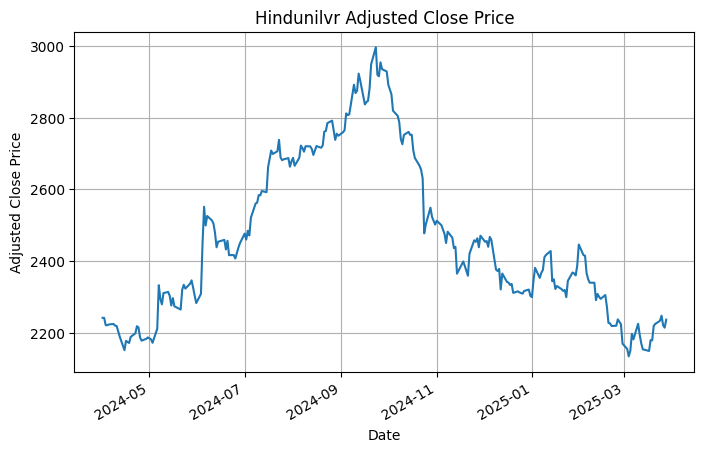

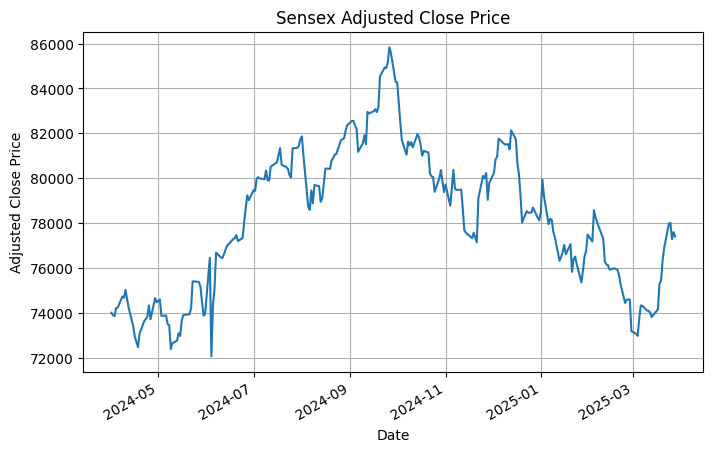

In [ ]:
for column in stock_data_df.columns:
    plt.figure(figsize=(8, 5))
    stock_data_df[column].plot()
    plt.title(f'{column} Adjusted Close Price')
    plt.xlabel('Date')
    plt.ylabel('Adjusted Close Price')
    plt.grid(True)
    plt.show()

# Calculating the Average daily return, Variance, and Standard deviation of each stock and the correlation matrix over the year

In [ ]:
annual_stats = {}

data = {
    'SunPharma': returns['SunPharma'],
    'SBI': returns['SBI'],
    'Eternal': returns['Eternal'],
    'Infosys': returns['Infosys'],
    'Hindunilvr': returns['Hindunilvr'],
    'Sensex': returns['Sensex']
}

# Compute mean, std, variance
for name, series in data.items():
    avg = series.mean()
    std = series.std()
    var = series.var()

    # Convert annual mean (in %) to daily mean
    annual_mean = ((1 + avg)**(252)) - 1

    annual_std = std * (252**0.5)

    annual_stats[name] = {
        'Daily Mean ': avg,
        'Daily Std ': std,
        'Daily Variance': var,
        'Annual Mean': annual_mean,
        'Annual Std': annual_std
    }

stats_df = pd.DataFrame(annual_stats).T
print(stats_df)
display(returns.describe())

            Daily Mean   Daily Std   Daily Variance  Annual Mean  Annual Std
SunPharma      0.000374    0.012657        0.000160     0.098716    0.200918
SBI            0.000307    0.018109        0.000328     0.080461    0.287479
Eternal        0.000718    0.026833        0.000720     0.198363    0.425963
Infosys        0.000442    0.015032        0.000226     0.117664    0.238619
Hindunilvr     0.000075    0.013022        0.000170     0.018991    0.206720
Sensex         0.000225    0.008983        0.000081     0.058391    0.142601


,SunPharma,SBI,Eternal,Infosys,Hindunilvr,Sensex
count,243.000000,243.000000,243.000000,243.000000,243.000000,243.000000
mean,0.000374,0.000307,0.000718,0.000442,0.000075,0.000225
std,0.012657,0.018109,0.026833,0.015032,0.013022,0.008983
min,-0.044715,-0.144182,-0.109151,-0.057678,-0.058333,-0.057406
25%,-0.006713,-0.008912,-0.017232,-0.006861,-0.006990,-0.003002
50%,0.000749,0.000670,-0.000512,0.000422,-0.000614,-0.000005
75%,0.008408,0.008668,0.017352,0.008542,0.006331,0.004474
max,0.037490,0.091194,0.121102,0.041324,0.060048,0.033902


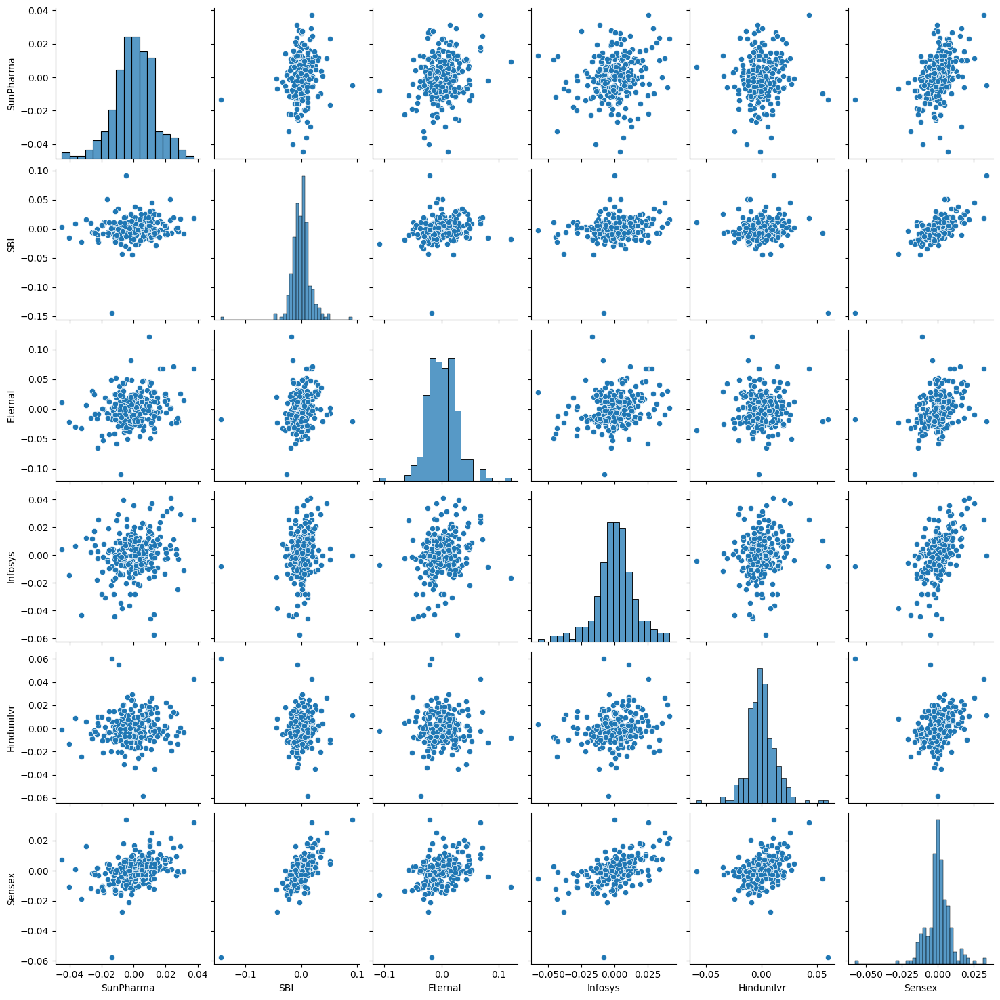

In [ ]:
sns.pairplot(returns)
plt.show()

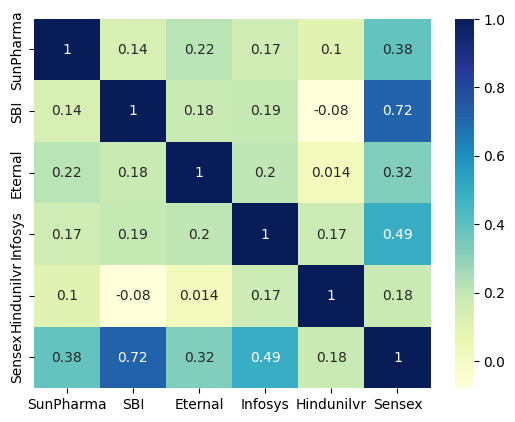

In [ ]:
sns.heatmap(returns.corr(), annot = True, cmap="YlGnBu")
plt.show()

# Calculation of the Risk-free Rate and CAPM

Daily Risk-Free rate is: 0.0002559748007688878
Mean Sensex Annual Return is: 0.05839093503206616

For the company: SBI
                            OLS Regression Results                            
Dep. Variable:                    SBI   R-squared:                       0.518
Model:                            OLS   Adj. R-squared:                  0.516
Method:                 Least Squares   F-statistic:                     258.7
Date:                Fri, 07 Nov 2025   Prob (F-statistic):           4.95e-40
Time:                        07:16:35   Log-Likelihood:                 719.04
No. Observations:                 243   AIC:                            -1434.
Df Residuals:                     241   BIC:                            -1427.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                           coef    std err          t      P>|t|      [0.025      0.975]
--

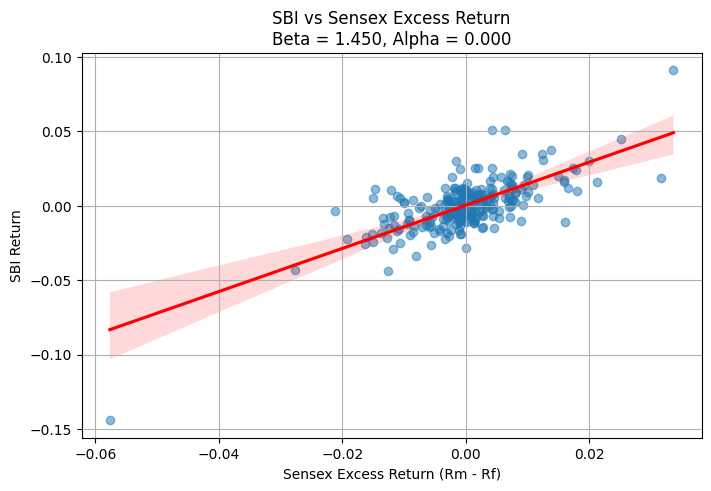

Residuals (first 10):
Date
2024-04-02    0.014256
2024-04-03    0.005243
2024-04-04   -0.022044
2024-04-05    0.006334
2024-04-08   -0.004338
2024-04-09   -0.004370
2024-04-10    0.012569
2024-04-12   -0.000372
2024-04-15    0.003618
2024-04-16    0.002493
Required Return of  SBI  is  0.05468270491721639

For the company: SunPharma
                            OLS Regression Results                            
Dep. Variable:              SunPharma   R-squared:                       0.147
Model:                            OLS   Adj. R-squared:                  0.143
Method:                 Least Squares   F-statistic:                     41.48
Date:                Fri, 07 Nov 2025   Prob (F-statistic):           6.40e-10
Time:                        07:16:36   Log-Likelihood:                 736.80
No. Observations:                 243   AIC:                            -1470.
Df Residuals:                     241   BIC:                            -1463.
Df Model:                         

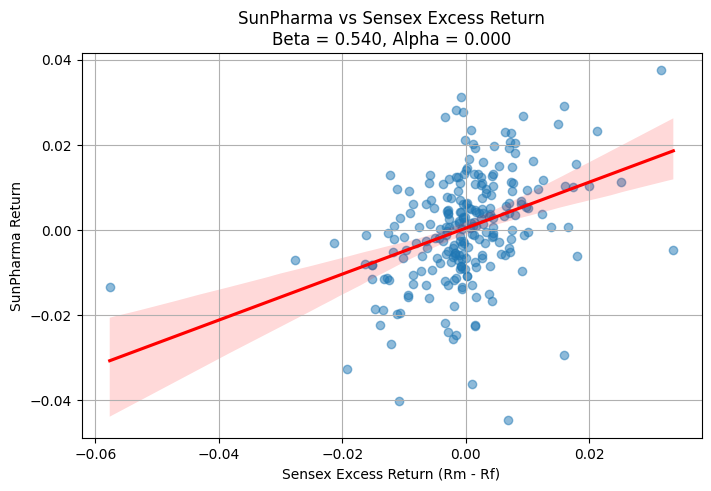

Residuals (first 10):
Date
2024-04-02   -0.004810
2024-04-03    0.000162
2024-04-04   -0.004295
2024-04-05   -0.007099
2024-04-08   -0.009781
2024-04-09    0.002173
2024-04-10   -0.002066
2024-04-12   -0.034663
2024-04-15    0.006868
2024-04-16    0.000378
Required Return of  SunPharma  is  0.06217840714371157

For the company: Eternal
                            OLS Regression Results                            
Dep. Variable:                Eternal   R-squared:                       0.105
Model:                            OLS   Adj. R-squared:                  0.102
Method:                 Least Squares   F-statistic:                     28.35
Date:                Fri, 07 Nov 2025   Prob (F-statistic):           2.32e-07
Time:                        07:16:36   Log-Likelihood:                 548.41
No. Observations:                 243   AIC:                            -1093.
Df Residuals:                     241   BIC:                            -1086.
Df Model:                     

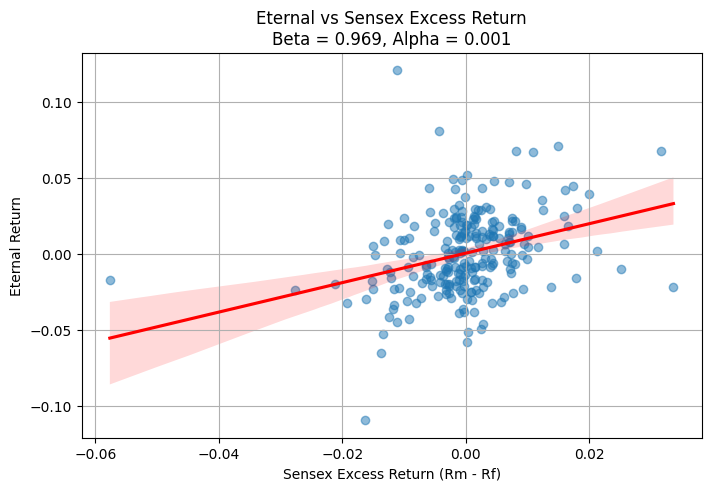

Residuals (first 10):
Date
2024-04-02   -0.007179
2024-04-03   -0.025548
2024-04-04    0.042824
2024-04-05    0.018220
2024-04-08   -0.000127
2024-04-09    0.010168
2024-04-10    0.010905
2024-04-12   -0.012359
2024-04-15   -0.012072
2024-04-16   -0.001655
Required Return of  Eternal  is  0.058645430949253126

For the company: Infosys
                            OLS Regression Results                            
Dep. Variable:                Infosys   R-squared:                       0.242
Model:                            OLS   Adj. R-squared:                  0.239
Method:                 Least Squares   F-statistic:                     76.79
Date:                Fri, 07 Nov 2025   Prob (F-statistic):           3.45e-16
Time:                        07:16:36   Log-Likelihood:                 709.32
No. Observations:                 243   AIC:                            -1415.
Df Residuals:                     241   BIC:                            -1408.
Df Model:                      

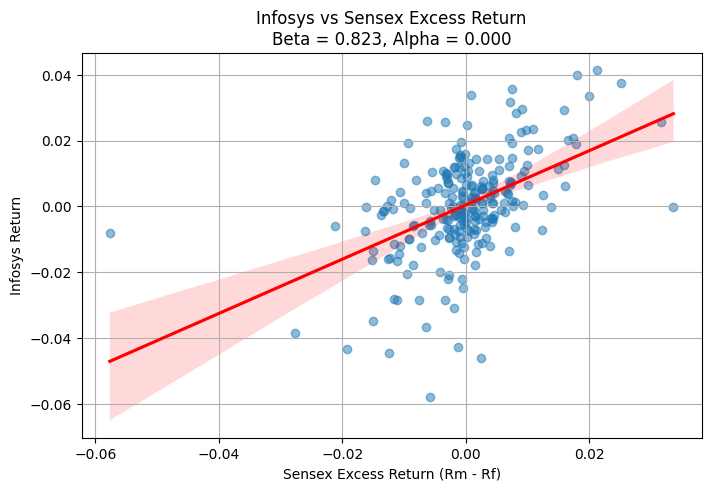

Residuals (first 10):
Date
2024-04-02   -0.007450
2024-04-03   -0.001607
2024-04-04   -0.000212
2024-04-05   -0.005260
2024-04-08   -0.007388
2024-04-09    0.012340
2024-04-10    0.003868
2024-04-12   -0.005930
2024-04-15   -0.002172
2024-04-16   -0.031616
Required Return of  Infosys  is  0.05985148510031053

For the company: Hindunilvr
                            OLS Regression Results                            
Dep. Variable:             Hindunilvr   R-squared:                       0.032
Model:                            OLS   Adj. R-squared:                  0.028
Method:                 Least Squares   F-statistic:                     7.976
Date:                Fri, 07 Nov 2025   Prob (F-statistic):            0.00514
Time:                        07:16:36   Log-Likelihood:                 714.54
No. Observations:                 243   AIC:                            -1425.
Df Residuals:                     241   BIC:                            -1418.
Df Model:                    

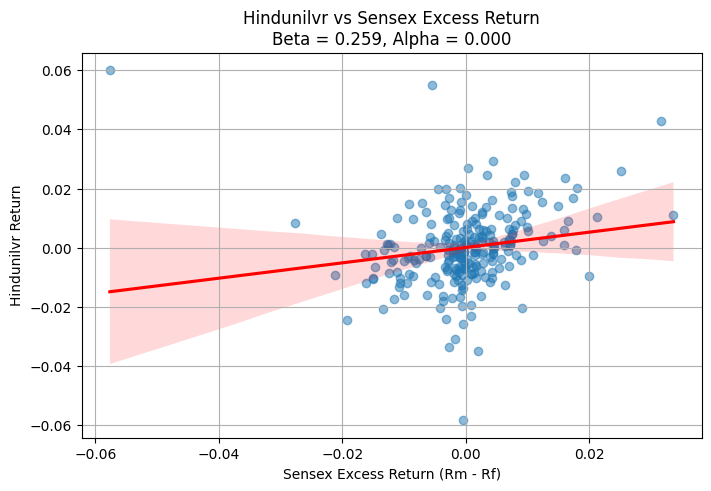

Residuals (first 10):
Date
2024-04-02    0.000306
2024-04-03   -0.008974
2024-04-04   -0.001359
2024-04-05    0.000861
2024-04-08   -0.001104
2024-04-09   -0.001927
2024-04-10   -0.001756
2024-04-12   -0.010617
2024-04-15   -0.014259
2024-04-16    0.013580
Required Return of  Hindunilvr  is  0.06448688899285557


In [ ]:
RF_ANNUAL_PCT = 6.66228/100
RF_DAILY = ((1 + RF_ANNUAL_PCT) ** (1/252)) - 1
print('Daily Risk-Free rate is:', RF_DAILY)
mean_of_sensex = returns['Sensex'].mean()
# --- Excess Market Return
returns = returns.copy()
returns['Return_Sensex_excess'] = returns['Sensex'] - RF_DAILY

# --- Companies list
cmps = ['SBI', 'SunPharma', 'Eternal', 'Infosys', 'Hindunilvr']
mean_sensex_annual=((1 + mean_of_sensex) ** (252)) - 1
print('Mean Sensex Annual Return is:', mean_sensex_annual)
# --- Regression Loop
for a in cmps:
    y = returns[a].dropna()
    x = returns.loc[y.index, 'Return_Sensex_excess']  # align indices
    x_sm = sm.add_constant(x)

    # Fit OLS model
    model = sm.OLS(y, x_sm)
    results = model.fit()

    # Print regression summary
    print('\n' + '='*80)
    print('For the company:', a)
    print(results.summary())

    # --- Plot each regression in its own figure
    plt.figure(figsize=(8,5))
    sns.regplot(x=x, y=y, scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
    plt.xlabel('Sensex Excess Return (Rm - Rf)')
    plt.ylabel(f'{a} Return')
    plt.title(f'{a} vs Sensex Excess Return\nBeta = {results.params["Return_Sensex_excess"]:.3f}, Alpha = {results.params["const"]:.3f}')
    plt.grid(True)
    plt.show()

    # Print residual info
    print('Residuals (first 10):')
    print(results.resid.head(10).to_string())
    alpha = results.params['const']                    # Intercept (α)
    beta = results.params['Return_Sensex_excess']      # Slope (β)
    expected_return=RF_ANNUAL_PCT+(mean_sensex_annual-RF_ANNUAL_PCT)*beta
    print("Required Return of ",a," is ",expected_return)


# Plotting the Efficient Frontiers Without Short Selling Only Domestic securities -MPT

In [ ]:
def PortfolioPerf(weights, meanReturns, covMatrix):
  returns = np.sum(meanReturns*weights )*252
  std = np.sqrt(np.dot(weights.T, np.dot(covMatrix, weights)))* np.sqrt(252)
  return returns, std

def negSR(weights, meanReturns, covMatrix, riskFreeRate):
  pReturns, pStdDev = PortfolioPerf(weights, meanReturns, covMatrix)
  return -(pReturns-riskFreeRate)/pStdDev

def maxSR(meanReturns, covMatrix, riskFreeRate, constraintSet = (0,1)):
  numAssets = len(meanReturns)
  args = (meanReturns, covMatrix, riskFreeRate)
  constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
  bound = constraintSet
  bounds = tuple(bound for asset in range(numAssets))
  result = sc.minimize(negSR, numAssets*[1./numAssets,], args=args,
                    method='SLSQP', bounds=bounds, constraints=constraints)
  return result

def PortfolioVariance(weights, meanReturns, covMatrix):
  return PortfolioPerf(weights, meanReturns, covMatrix)[1]

def PortfolioReturn(weights, meanReturns, covMatrix):
  return PortfolioPerf(weights, meanReturns, covMatrix)[0]

def minimumVariance(meanReturns, covMatrix, constraintSet=(0,1)):
  numAssets = len(meanReturns)
  args = (meanReturns, covMatrix)
  constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
  bound = constraintSet
  bounds = tuple(bound for asset in range(numAssets))
  result = sc.minimize(PortfolioVariance, numAssets*[1./numAssets,], args=args,
                    method='SLSQP', bounds=bounds, constraints=constraints)
  return result

def negPortfolioReturn(weights, meanReturns, covMatrix):
  return -PortfolioPerf(weights, meanReturns, covMatrix)[0]

def maximumReturn(meanReturns, covMatrix,  constraintSet=(0,1)):
  numAssets = len(meanReturns)
  args = (meanReturns, covMatrix)
  constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
  bound = constraintSet
  bounds = tuple(bound for asset in range(numAssets))
  result = sc.minimize(negPortfolioReturn, numAssets*[1./numAssets,], args = args,
                      method='SLSQP', bounds=bounds, constraints=constraints)

  return result


def calcResults(meanReturns, covMatrix, riskFreeRate, constraintSet=(0,1)):
  maxSRPortfolio = maxSR(meanReturns, covMatrix, riskFreeRate, constraintSet)
  maxSRweights = maxSRPortfolio['x']
  maxSRreturns, maxSRstd = PortfolioPerf(maxSRweights, meanReturns, covMatrix)
  maxSRallocation = pd.DataFrame(maxSRPortfolio['x'], index = meanReturns.index, columns=['Allocation'])
  maxSRallocation.Allocation = [round(i*100, 2) for i in  maxSRallocation.Allocation]

  minVarPortfolio = minimumVariance(meanReturns, covMatrix, constraintSet)
  minVarweights = minVarPortfolio['x']
  minVarreturns, minVarstd = PortfolioPerf(minVarweights, meanReturns, covMatrix)
  minVarallocation = pd.DataFrame(minVarPortfolio['x'], index = meanReturns.index, columns=['Allocation'])
  minVarallocation.Allocation = [round(i*100, 2) for i in  minVarallocation.Allocation]

  maxRetPortfolio = maximumReturn(meanReturns, covMatrix, constraintSet)
  maxRetweights = maxRetPortfolio['x']
  maxRetreturns, maxRetstd = PortfolioPerf(maxRetweights, meanReturns, covMatrix)

  minVarreturns, minVarstd = round(minVarreturns*100, 2), round(minVarstd*100, 2)
  maxSRreturns, maxSRstd = round(maxSRreturns*100, 2), round(maxSRstd*100, 2)
  maxRetreturns, maxRetstd = round(maxRetreturns*100, 2), round(maxRetstd*100, 2)
  print(f"**Max Sharpe Ratio Portfolio:**")
  print(f"Returns: {maxSRreturns:.2f}%")
  print(f"Volatility: {maxSRstd:.2f}%")
  print("Allocation:")
  display(maxSRallocation)

  print(f"**Min Variance Portfolio:**")
  print(f"Returns: {minVarreturns:.2f}%")
  print(f"Volatility: {minVarstd:.2f}%")
  print("Allocation:")
  display(minVarallocation)

  print(f"**Max Return Portfolio:**")
  print(f"Returns: {maxRetreturns:.2f}%")
  print(f"Volatility: {maxRetstd:.2f}%")
  print("Allocation:")
  maxRetallocation = pd.DataFrame(maxRetweights, index = meanReturns.index, columns=['Allocation'])
  maxRetallocation.Allocation = [round(i*100, 2) for i in  maxRetallocation.Allocation]
  display(maxRetallocation)

def simulation_frontier(meanReturns, covMatrix, riskFreeRate, simulations=5000):
    numAssets = len(meanReturns)
    portfolio_returns = []
    portfolio_volatility = []
    portfolio_weights = []
    portfolio_sharpe = []

    np.random.seed(42)

    for _ in range(simulations):
        weights = np.random.random(numAssets)
        weights = weights / np.sum(weights)
        portfolio_weights.append(weights)

        p_return, p_std = PortfolioPerf(weights, meanReturns, covMatrix)
        portfolio_returns.append(p_return)
        portfolio_volatility.append(p_std)

        sharpe = (p_return - riskFreeRate) / p_std
        portfolio_sharpe.append(sharpe)

    results = pd.DataFrame({
        'Returns': portfolio_returns,
        'Volatility': portfolio_volatility,
        'Sharpe': portfolio_sharpe
    })

    for i, asset_name in enumerate(meanReturns.index):
        results[f'{asset_name}_weight'] = [w[i] for w in portfolio_weights]

    return results

def ef_graph(meanReturns, covMatrix, riskFreeRate, simulations=50000):
    simulated_portfolios = simulation_frontier(meanReturns, covMatrix, riskFreeRate, simulations)
    maxSRresult = maxSR(meanReturns, covMatrix, riskFreeRate)
    maxSRweights = maxSRresult['x']
    maxSRreturns, maxSRstd = PortfolioPerf(maxSRweights, meanReturns, covMatrix)

    minVarresult = minimumVariance(meanReturns, covMatrix)
    minVarweights = minVarresult['x']
    minVarreturns, minVarstd = PortfolioPerf(minVarweights, meanReturns, covMatrix)

    sharpe_ratio = (maxSRreturns - riskFreeRate) / maxSRstd
    cal_vol_max = maxSRstd * 1.25
    cal_vol = np.linspace(0, cal_vol_max, 100)
    cal_returns = riskFreeRate + sharpe_ratio * cal_vol


    fig = go.Figure()
    fig.add_trace(go.Scatter(
        x=simulated_portfolios['Volatility'] * 100,
        y=simulated_portfolios['Returns'] * 100,
        mode='markers',
        marker=dict(size=4,color=simulated_portfolios['Sharpe'], colorscale='Viridis',showscale=True,colorbar=dict(title='Sharpe Ratio'),opacity=0.6),
        text=[f"Return: {r:.2f}%<br>Volatility: {v:.2f}%<br>Sharpe: {s:.3f}"
              for r, v, s in zip(simulated_portfolios['Returns']*100, simulated_portfolios['Volatility']*100, simulated_portfolios['Sharpe'])],name='Simulated Portfolios'
    ))

    fig.add_trace(go.Scatter(
      x=cal_vol * 100,
      y=cal_returns * 100,
      mode='lines',
      line=dict(color='blue', width=3, dash='dash'),
      name=f'Capital Allocation Line (SR={sharpe_ratio:.3f})'
    ))

    fig.add_trace(go.Scatter(
        x=[maxSRstd * 100],
        y=[maxSRreturns * 100],
        mode='markers+text',
        marker=dict(size=10, color='green', symbol='star'),
        text=['Max Sharpe Ratio'],
        textposition='top center',
        name='Max Sharpe Ratio'
    ))

    fig.add_trace(go.Scatter(
        x=[minVarstd * 100],
        y=[minVarreturns * 100],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='square'),
        text=['Min Variance'],
        textposition='bottom center',
        name='Min Variance'
    ))

    fig.update_layout(
        title='Efficient Frontier',
        xaxis=dict(title='Annualized Volatility (%)', gridwidth=1),
        yaxis=dict(title='Annualized Return (%)', gridwidth=1),
        width=1000,
        height=700,
        showlegend=True,
        legend=dict(x=0.99, y=0.99,xanchor='right', yanchor='top',bgcolor='#F2F2F2',bordercolor='black',borderwidth=1),
        hovermode='closest',
        template='plotly_white'
    )
    return fig.show()

df = returns.drop(columns=['Sensex', 'Return_Sensex_excess'])
riskFreeRate = RF_ANNUAL_PCT
meanReturns = df.mean()
covMatrix = df.cov()

calcResults(meanReturns, covMatrix, riskFreeRate)
ef_graph(meanReturns, covMatrix, riskFreeRate)

**Max Sharpe Ratio Portfolio:**
Returns: 13.38%
Volatility: 21.86%
Allocation:


,Allocation
SunPharma,23.30
SBI,0.00
Eternal,38.06
Infosys,38.64
Hindunilvr,0.00


**Min Variance Portfolio:**
Returns: 6.95%
Volatility: 12.98%
Allocation:


,Allocation
SunPharma,30.81
SBI,16.44
Eternal,2.17
Infosys,15.45
Hindunilvr,35.13


**Max Return Portfolio:**
Returns: 18.10%
Volatility: 42.60%
Allocation:


,Allocation
SunPharma,0.0
SBI,0.0
Eternal,100.0
Infosys,0.0
Hindunilvr,0.0


#Plotting Efficient Frontiers With Short Selling Only Domestic Securities

In [ ]:
def maxSR_ss(meanReturns, covMatrix, riskFreeRate, constraintSet = (-1,1)):
  numAssets = len(meanReturns)
  args = (meanReturns, covMatrix, riskFreeRate)
  constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1},
                 {'type': 'ineq', 'fun': lambda x: 2 - np.sum(np.abs(x))})
  bound = constraintSet
  bounds = tuple(bound for asset in range(numAssets))
  result = sc.minimize(negSR, numAssets*[1./numAssets,], args=args,
                    method='SLSQP', bounds = bounds, constraints=constraints)
  return result

def minimumVariance_ss(meanReturns, covMatrix, constraintSet=(-1,1)):
  numAssets = len(meanReturns)
  args = (meanReturns, covMatrix)
  constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1},
                 {'type': 'ineq', 'fun': lambda x: 2 - np.sum(np.abs(x))})
  bound = constraintSet
  bounds = tuple(bound for asset in range(numAssets))
  result = sc.minimize(PortfolioVariance, numAssets*[1./numAssets,], args=args,
                    method='SLSQP', bounds = bounds, constraints=constraints)
  return result


def maximumReturn_ss(meanReturns, covMatrix,  constraintSet=(-1,1)):
  numAssets = len(meanReturns)
  args = (meanReturns, covMatrix)
  constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1},
                 {'type': 'ineq', 'fun': lambda x: 2 - np.sum(np.abs(x))})
  bound = constraintSet
  bounds = tuple(bound for asset in range(numAssets))
  result = sc.minimize(negPortfolioReturn, numAssets*[1./numAssets,], args = args,
                      method='SLSQP', bounds = bounds, constraints=constraints)

  return result


def calcResults_ss(meanReturns, covMatrix, riskFreeRate, constraintSet=(-1,1)):
  maxSRPortfolio = maxSR_ss(meanReturns, covMatrix, riskFreeRate, constraintSet)
  maxSRweights = maxSRPortfolio['x']
  maxSRreturns, maxSRstd = PortfolioPerf(maxSRweights, meanReturns, covMatrix)
  maxSRallocation = pd.DataFrame(maxSRPortfolio['x'], index = meanReturns.index, columns=['Allocation'])
  maxSRallocation.Allocation = [round(i*100, 2) for i in  maxSRallocation.Allocation]

  minVarPortfolio = minimumVariance_ss(meanReturns, covMatrix, constraintSet)
  minVarweights = minVarPortfolio['x']
  minVarreturns, minVarstd = PortfolioPerf(minVarweights, meanReturns, covMatrix)
  minVarallocation = pd.DataFrame(minVarPortfolio['x'], index = meanReturns.index, columns=['Allocation'])
  minVarallocation.Allocation = [round(i*100, 2) for i in  minVarallocation.Allocation]

  maxRetPortfolio = maximumReturn_ss(meanReturns, covMatrix, constraintSet)
  maxRetweights = maxRetPortfolio['x']
  maxRetreturns, maxRetstd = PortfolioPerf(maxRetweights, meanReturns, covMatrix)
  maxRetallocation = pd.DataFrame(maxRetweights, index = meanReturns.index, columns=['Allocation'])
  maxRetallocation.Allocation = [round(i*100, 2) for i in  maxRetallocation.Allocation]

  minVarreturns, minVarstd = round(minVarreturns*100, 2), round(minVarstd*100, 2)
  maxSRreturns, maxSRstd = round(maxSRreturns*100, 2), round(maxSRstd*100, 2)
  maxRetreturns, maxRetstd = round(maxRetreturns*100, 2), round(maxRetstd*100, 2)
  print(f"**Max Sharpe Ratio Portfolio:**")
  print(f"Returns: {maxSRreturns:.2f}%")
  print(f"Volatility: {maxSRstd:.2f}%")
  print("Allocation:")
  display(maxSRallocation)

  print(f"**Min Variance Portfolio:**")
  print(f"Returns: {minVarreturns:.2f}%")
  print(f"Volatility: {minVarstd:.2f}%")
  print("Allocation:")
  display(minVarallocation)

  print(f"**Max Return Portfolio:**")
  print(f"Returns: {maxRetreturns:.2f}%")
  print(f"Volatility: {maxRetstd:.2f}%")
  print("Allocation:")
  display(maxRetallocation)

def simulation_frontier_ss(meanReturns, covMatrix, riskFreeRate, simulations=5000):
    numAssets = len(meanReturns)
    portfolio_returns = []
    portfolio_volatility = []
    portfolio_weights = []
    portfolio_sharpe = []

    np.random.seed(42)
    max_trials = simulations * 10
    trials = 0

    while len(portfolio_weights) < simulations and trials < max_trials:
        weights = np.random.uniform(-1, 1, numAssets)
        weights = weights / np.sum(weights)
        gross = np.sum(np.abs(weights))
        if gross <= 2:
            portfolio_weights.append(weights)
            p_return = np.sum(meanReturns * weights) * 252
            p_std = np.sqrt(np.dot(weights.T, np.dot(covMatrix, weights))) * np.sqrt(252)
            portfolio_returns.append(p_return)
            portfolio_volatility.append(p_std)
            sharpe = (p_return - riskFreeRate) / p_std
            portfolio_sharpe.append(sharpe)
        trials += 1

    results = pd.DataFrame({
        'Returns': portfolio_returns,
        'Volatility': portfolio_volatility,
        'Sharpe': portfolio_sharpe
    })

    for i, asset_name in enumerate(meanReturns.index):
        results[f'{asset_name}_weight'] = [w[i] for w in portfolio_weights]
    return results


def ef_graph_ss(meanReturns, covMatrix, riskFreeRate, simulations=50000):
    simulated_portfolios = simulation_frontier_ss(meanReturns, covMatrix, riskFreeRate, simulations)
    maxSRresult = maxSR_ss(meanReturns, covMatrix, riskFreeRate)
    maxSRweights = maxSRresult['x']
    maxSRreturns, maxSRstd = PortfolioPerf(maxSRweights, meanReturns, covMatrix)

    minVarresult = minimumVariance_ss(meanReturns, covMatrix)
    minVarweights = minVarresult['x']
    minVarreturns, minVarstd = PortfolioPerf(minVarweights, meanReturns, covMatrix)

    sharpe_ratio = (maxSRreturns - riskFreeRate) / maxSRstd
    cal_vol_max = maxSRstd * 1.25
    cal_vol = np.linspace(0, cal_vol_max, 100)
    cal_returns = riskFreeRate + sharpe_ratio * cal_vol

    fig = go.Figure()
    fig.add_trace(go.Scatter(
        x=simulated_portfolios['Volatility'] * 100,
        y=simulated_portfolios['Returns'] * 100,
        mode='markers',
        marker=dict(size=4,color=simulated_portfolios['Sharpe'], colorscale='Viridis',showscale=True,colorbar=dict(title='Sharpe Ratio'),opacity=0.6),
        text=[f"Return: {r:.2f}%<br>Volatility: {v:.2f}%<br>Sharpe: {s:.3f}"
              for r, v, s in zip(simulated_portfolios['Returns']*100, simulated_portfolios['Volatility']*100, simulated_portfolios['Sharpe'])],name='Simulated Portfolios'
    ))

    fig.add_trace(go.Scatter(
      x=cal_vol * 100,
      y=cal_returns * 100,
      mode='lines',
      line=dict(color='blue', width=3, dash='dash'),
      name=f'Capital Allocation Line (SR={sharpe_ratio:.3f})'
    ))

    fig.add_trace(go.Scatter(
        x=[maxSRstd * 100],
        y=[maxSRreturns * 100],
        mode='markers+text',
        marker=dict(size=10, color='green', symbol='star'),
        text=['Max Sharpe Ratio'],
        textposition='top center',
        name='Max Sharpe Ratio'
    ))

    fig.add_trace(go.Scatter(
        x=[minVarstd * 100],
        y=[minVarreturns * 100],
        mode='markers+text',
        marker=dict(size=10, color='red', symbol='square'),
        text=['Min Variance'],
        textposition='bottom center',
        name='Min Variance'
    ))

    fig.update_layout(
        title='Efficient Frontier',
        xaxis=dict(title='Annualized Volatility (%)', gridwidth=1),
        yaxis=dict(title='Annualized Return (%)', gridwidth=1),
        width=1000,
        height=700,
        showlegend=True,
        legend=dict(x=0.99, y=0.99,xanchor='right', yanchor='top',bgcolor='#F2F2F2',bordercolor='black',borderwidth=1),
        hovermode='closest',
        template='plotly_white'
    )
    return fig.show()

df = returns.drop(columns=['Sensex', 'Return_Sensex_excess'])
riskFreeRate = RF_ANNUAL_PCT
meanReturns = df.mean()
covMatrix = df.cov()

calcResults_ss(meanReturns, covMatrix, riskFreeRate)
ef_graph_ss(meanReturns, covMatrix, riskFreeRate)

**Max Sharpe Ratio Portfolio:**
Returns: 17.92%
Volatility: 29.74%
Allocation:


,Allocation
SunPharma,46.66
SBI,-0.00
Eternal,42.55
Infosys,60.79
Hindunilvr,-50.00


**Min Variance Portfolio:**
Returns: 6.95%
Volatility: 12.98%
Allocation:


,Allocation
SunPharma,30.81
SBI,16.44
Eternal,2.17
Infosys,15.45
Hindunilvr,35.13


**Max Return Portfolio:**
Returns: 22.72%
Volatility: 47.07%
Allocation:


,Allocation
SunPharma,0.0
SBI,-0.0
Eternal,100.0
Infosys,50.0
Hindunilvr,-50.0


# Downloading Apple Data and calculating the returns over the year

In [ ]:
aapl_data = yf.download(
    'AAPL',
    start='2024-04-01',
    end='2025-03-31',
    progress=False,
    interval='1d'
)['Close']

aapl_returns = (aapl_data - aapl_data.shift(1)) / aapl_data.shift(1)

aapl_returns.name = 'Apple'
aapl_returns = aapl_returns.dropna()
display(aapl_returns.head())

/tmp/ipython-input-3750778847.py:1: FutureWarning:

YF.download() has changed argument auto_adjust default to True



Ticker,AAPL
Date,
2024-04-02,-0.006999
2024-04-03,0.004797
2024-04-04,-0.004892
2024-04-05,0.004502
2024-04-08,-0.006664


In [ ]:

returns = returns.drop( columns = ['Return_Sensex_excess'])
return_with_apple = pd.concat([returns, aapl_returns], axis=1)

return_with_apple = return_with_apple.dropna()
display(return_with_apple.head())

,SunPharma,SBI,Eternal,Infosys,Hindunilvr,Sensex,AAPL
Date,,,,,,,
2024-04-02,-0.005365,0.012068,-0.008128,-0.008424,-0.000066,-0.001495,-0.006999
2024-04-03,0.000216,0.004692,-0.025403,-0.001652,-0.009053,-0.000367,0.004797
2024-04-04,-0.001479,-0.015176,0.047926,0.003951,-0.000110,0.004749,-0.004892
2024-04-05,-0.006698,0.006717,0.018989,-0.004776,0.000949,0.000277,0.004502
2024-04-08,-0.005935,0.005299,0.006824,-0.001656,0.000639,0.006657,-0.006664


#Plotting the Covariance Matrix

In [ ]:

portfolio_assets_returns = return_with_apple.drop(columns=['Sensex'])

mean_returns_with_apple = portfolio_assets_returns.mean()
cov_matrix_with_apple = portfolio_assets_returns.cov()

print("\nMean daily returns:")
display(mean_returns_with_apple)
print("\nCovariance matrix:")
display(cov_matrix_with_apple)




Mean daily returns:


,0
SunPharma,0.000482
SBI,0.000147
Eternal,0.000806
Infosys,0.000512
Hindunilvr,0.000089
AAPL,0.001120



Covariance matrix:


,SunPharma,SBI,Eternal,Infosys,Hindunilvr,AAPL
SunPharma,0.000163,0.000033,0.000078,0.000032,0.000017,-0.000006
SBI,0.000033,0.000337,0.000090,0.000054,-0.000018,0.000042
Eternal,0.000078,0.000090,0.000726,0.000085,0.000008,0.000022
Infosys,0.000032,0.000054,0.000085,0.000227,0.000034,0.000007
Hindunilvr,0.000017,-0.000018,0.000008,0.000034,0.000174,-0.000002
AAPL,-0.000006,0.000042,0.000022,0.000007,-0.000002,0.000237


Text(0.5, 1.0, 'Correlation Matrix (including Apple Inc.)')

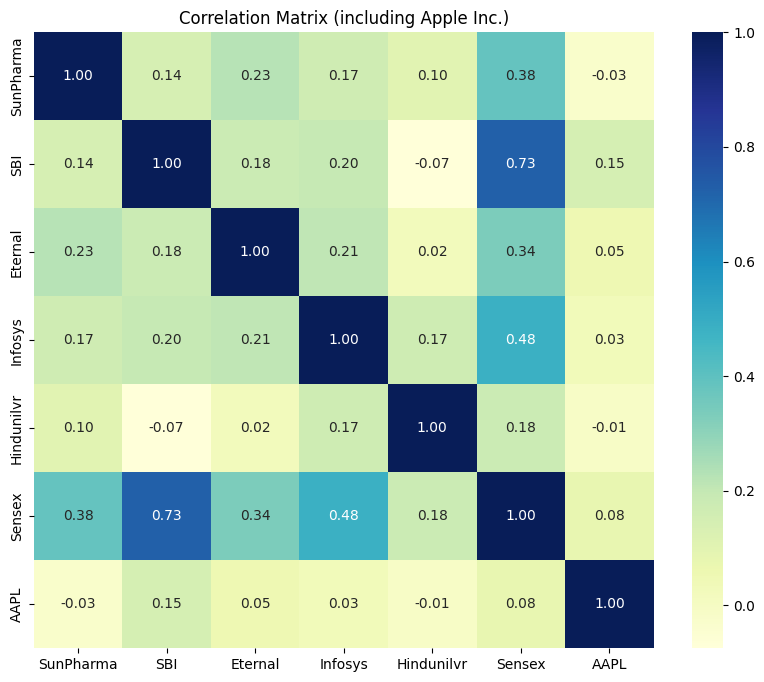

In [ ]:
plt.figure(figsize=(10, 8))

sns.heatmap(
    return_with_apple.corr(),
    annot=True,
    cmap="YlGnBu",
    fmt='.2f'
)

plt.title('Correlation Matrix (including Apple Inc.)')


# Plotting the Efficient Frontiers with Apple

In [ ]:
df = return_with_apple.drop(columns=['Sensex'])
riskFreeRate = RF_ANNUAL_PCT
meanReturns = df.mean()
covMatrix = df.cov()

calcResults(meanReturns, covMatrix, riskFreeRate)
ef_graph(meanReturns, covMatrix, riskFreeRate)


**Max Sharpe Ratio Portfolio:**
Returns: 22.79%
Volatility: 16.68%
Allocation:


,Allocation
SunPharma,19.29
SBI,0.00
Eternal,7.65
Infosys,11.25
Hindunilvr,0.00
AAPL,61.81


**Min Variance Portfolio:**
Returns: 12.22%
Volatility: 11.77%
Allocation:


,Allocation
SunPharma,26.38
SBI,10.16
Eternal,1.03
Infosys,12.77
Hindunilvr,27.81
AAPL,21.85


**Max Return Portfolio:**
Returns: 28.21%
Volatility: 24.42%
Allocation:


,Allocation
SunPharma,0.0
SBI,0.0
Eternal,0.0
Infosys,0.0
Hindunilvr,0.0
AAPL,100.0


In [ ]:
df = return_with_apple.drop(columns=['Sensex'])
riskFreeRate = RF_ANNUAL_PCT
meanReturns = df.mean()
covMatrix = df.cov()

calcResults_ss(meanReturns, covMatrix, riskFreeRate)
ef_graph_ss(meanReturns, covMatrix, riskFreeRate)


**Max Sharpe Ratio Portfolio:**
Returns: 31.18%
Volatility: 23.01%
Allocation:


,Allocation
SunPharma,31.89
SBI,-25.37
Eternal,11.45
Infosys,23.65
Hindunilvr,-24.63
AAPL,83.01


**Min Variance Portfolio:**
Returns: 12.22%
Volatility: 11.77%
Allocation:


,Allocation
SunPharma,26.38
SBI,10.16
Eternal,1.03
Infosys,12.77
Hindunilvr,27.81
AAPL,21.85


**Max Return Portfolio:**
Returns: 37.25%
Volatility: 34.83%
Allocation:


,Allocation
SunPharma,-0.0
SBI,-0.0
Eternal,50.0
Infosys,0.0
Hindunilvr,-50.0
AAPL,100.0
